In [2]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import yfinance as yf
import pandas as pd
import random
import plotly.express as px
import plotly.graph_objects as go

import numpy as np
import scipy.stats as scs

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import permutation_importance
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc
from collections import Counter, deque
from dateutil.relativedelta import relativedelta
import holidays
from dtaidistance import preprocessing
from datetime import date
import datetime

from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler
from tslearn.utils import to_time_series_dataset
from tslearn.clustering import silhouette_score


In [3]:
end = pd.to_datetime('2024-01-21')
start = pd.to_datetime('2024-01-21') - relativedelta(weeks=103)


years = [end.year-i for i in range(end.year-start.year + 1)]
nyse_holidays = holidays.NYSE(years=years)

### Import data from CSV

In [4]:
data = pd.read_csv('SP500_Hourly_102Weeks_2024_01_14.csv', index_col=0, parse_dates=True)  
data.index = pd.to_datetime(data.index, utc=True).tz_convert('America/New_York')
data.head(10)

,Open,High,Low,Close,Adj Close,Volume
Datetime,,,,,,
2022-01-31 09:30:00-05:00,4431.790039,4472.020020,4414.020020,4458.209961,4458.209961,0
2022-01-31 10:30:00-05:00,4458.339844,4468.830078,4452.740234,4455.779785,4455.779785,310320785
2022-01-31 11:30:00-05:00,4456.299805,4483.180176,4453.419922,4477.540039,4477.540039,259708983
2022-01-31 12:30:00-05:00,4477.490234,4489.350098,4473.399902,4482.819824,4482.819824,237902000
2022-01-31 13:30:00-05:00,4482.890137,4497.709961,4479.939941,4497.709961,4497.709961,218623000
2022-01-31 14:30:00-05:00,4497.750000,4497.930176,4471.459961,4486.180176,4486.180176,291230000
2022-01-31 15:30:00-05:00,4486.189941,4516.890137,4482.020020,4515.439941,4515.439941,464471000
2022-02-01 09:30:00-05:00,4519.569824,4525.560059,4483.529785,4501.950195,4501.950195,0
2022-02-01 10:30:00-05:00,4501.970215,4522.270020,4493.779785,4512.879883,4512.879883,349426580


In [5]:
df = pd.DataFrame(data.Close)
df.head()

,Close
Datetime,
2022-01-31 09:30:00-05:00,4458.209961
2022-01-31 10:30:00-05:00,4455.779785
2022-01-31 11:30:00-05:00,4477.540039
2022-01-31 12:30:00-05:00,4482.819824
2022-01-31 13:30:00-05:00,4497.709961


<Axes: title={'center': 'SP500 Hourly Closing Prices'}, xlabel='Datetime'>

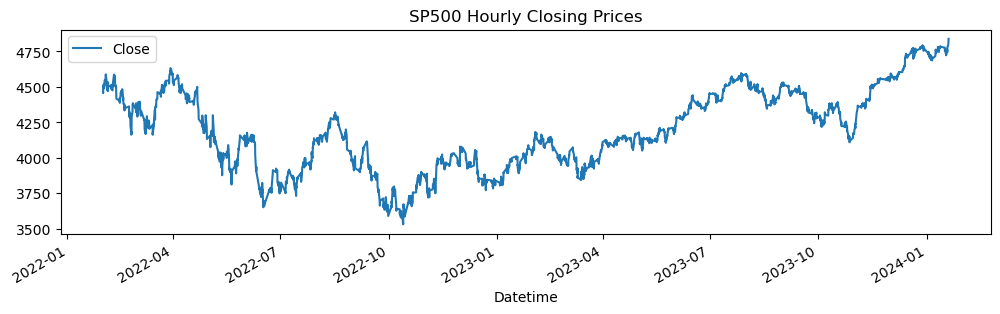

In [6]:
# Plot the data
df.plot(title="SP500 Hourly Closing Prices", figsize=(12, 3))

#### Imputation (Optional)

In [7]:
def generate_trading_day_index(date):
    date = date.tz_localize(None)
    if date.dst() == datetime.timedelta(hours = 1):
        hourly_time = ['09:30:00-0400', '10:30:00-04:00', '11:30:00-04:00', '12:30:00-04:00', '13:30:00-04:00', '14:30:00-04:00', '15:30:00-04:00']
    else:
        hourly_time = ['09:30:00-0500', '10:30:00-05:00', '11:30:00-05:00', '12:30:00-05:00', '13:30:00-05:00', '14:30:00-05:00', '15:30:00-05:00']
    return [pd.Timestamp(date.strftime('%Y-%m-%d') + ' ' + time, tz='America/New_York') for time in hourly_time]


# Impute for holidays
def impute_holidays(df, holidays):
    '''df has Datetimeindex'''
    for day in holidays:
        day = pd.Timestamp(day, tz='America/New_York')
        print(day.date())
        print(df.index)
        if df.index[-1].date() < day.date() or df.index[0].date() > day.date():
            # Skipping holidays that are beyond todays date or much earlier than dataset's earliest date
            continue
#         if day.weekday() == 5 or day.weekday() == 6:
#             # Ignoring weekends
#             continue
        if day in df.index:
            # Ignore if holiday has been imputed
            continue
        
        # Impute holiday prices with the day before's
        print(f"Imputing for day: {day}")
#         display(df.loc[df.index.date < day.date()])
        daybefore_price = df.loc[df.index.date < day.date()].Close.iat[-1]
        print(daybefore_price)
        new_df = pd.DataFrame([daybefore_price for i in range(7)], index = generate_trading_day_index(day))
        new_df.columns = ['Close']
#         display(new_df)
        df = pd.concat([df, new_df])
        df.sort_index(inplace=True)
        
    return df

# Impute for half days
def impute_halfdays(df):
    tmp_df = df.groupby(pd.Grouper(freq='D')).count()
    halfdays = list(tmp_df.loc[(tmp_df.Close < 7) & (tmp_df.Close != 0)].index)
    print(f"Detected Halfdays to impute: {[x.date() for x in halfdays]}")

    for day in halfdays:
    #     print(day.dst() == datetime.timedelta(hours = 1))
        hourbefore_prices = df.loc[df.index.date == day.date()]
        hourbefore_price = hourbefore_prices.Close.iat[-1]
        indexes = generate_trading_day_index(day)
        filtered_indexes = []
        prices = []
        for index in indexes:
            if hourbefore_prices.loc[hourbefore_prices.index == index].empty:
                prices.append(hourbefore_price)
                filtered_indexes.append(index)

        new_df = pd.DataFrame(prices, index = filtered_indexes)
        new_df.columns = ['Close']
#         display(new_df)
        df = pd.concat([df, new_df])
        df.sort_index(inplace=True)
        
    return df

def impute_weekends(df):
    start_date = df.index[0].tz_localize(None)
    end_date = df.index[-1].tz_localize(None)
    weekends = pd.bdate_range(start=start_date, end=end_date, freq="C", weekmask="Sat Sun")
    print("Here")
    print(weekends)
    return impute_holidays(df, weekends)


print(df.shape)

print("Impute Holidays")
imputed_df = impute_holidays(df, nyse_holidays)  
print(imputed_df.shape)

print("Impute Halfdays")
imputed_df = impute_halfdays(imputed_df)
print(imputed_df.shape)

print("Impute Weekends")
imputed_df = impute_weekends(imputed_df)
print(imputed_df.shape)

(3453, 1)
Impute Holidays
2024-01-01
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', name='Datetime', length=3453, freq=None)
Imputing for day: 2024-01-01 00:00:00-05:00
4772.169921875
2024-01-15
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2

Imputing for day: 2022-02-26 00:00:00-05:00
4384.830078125
2022-02-27
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', length=3655, freq=None)
Imputing for day: 2022-02-27 00:00:00-05:00
4384.830078125
2022-03-05
DatetimeIndex(['2022-01-31 09:

Imputing for day: 2022-05-29 00:00:00-04:00
4158.33984375
2022-06-04
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', length=3844, freq=None)
Imputing for day: 2022-06-04 00:00:00-04:00
4108.22998046875
2022-06-05
DatetimeIndex(['2022-01-31 09

3925.2900390625
2022-09-10
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', length=4040, freq=None)
Imputing for day: 2022-09-10 00:00:00-04:00
4067.6201171875
2022-09-11
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',

3851.02001953125
2022-12-24
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', length=4250, freq=None)
Imputing for day: 2022-12-24 00:00:00-05:00
3844.449951171875
2022-12-25
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:0

2023-04-15
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', length=4474, freq=None)
Imputing for day: 2023-04-15 00:00:00-04:00
4137.47021484375
2023-04-16
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
              

4478.5498046875
2023-08-06
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', length=4705, freq=None)
Imputing for day: 2023-08-06 00:00:00-04:00
4478.5498046875
2023-08-12
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',

4513.91015625
2023-11-19
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
               '2022-01-31 11:30:00-05:00', '2022-01-31 12:30:00-05:00',
               '2022-01-31 13:30:00-05:00', '2022-01-31 14:30:00-05:00',
               '2022-01-31 15:30:00-05:00', '2022-02-01 09:30:00-05:00',
               '2022-02-01 10:30:00-05:00', '2022-02-01 11:30:00-05:00',
               ...
               '2024-01-18 13:30:00-05:00', '2024-01-18 14:30:00-05:00',
               '2024-01-18 15:30:00-05:00', '2024-01-19 09:30:00-05:00',
               '2024-01-19 10:30:00-05:00', '2024-01-19 11:30:00-05:00',
               '2024-01-19 12:30:00-05:00', '2024-01-19 13:30:00-05:00',
               '2024-01-19 14:30:00-05:00', '2024-01-19 15:30:00-05:00'],
              dtype='datetime64[ns, America/New_York]', length=4915, freq=None)
Imputing for day: 2023-11-19 00:00:00-05:00
4513.91015625
2023-11-25
DatetimeIndex(['2022-01-31 09:30:00-05:00', '2022-01-31 10:30:00-05:00',
   

### Differencing to get Log Returns which is more suitable for switching variance MSM

In [8]:
df_time_series = df.Close.ravel()
df_differenced_time_series = preprocessing.differencing(np.log(df_time_series), smooth=0.1)
df_differenced = pd.DataFrame(df_differenced_time_series, index=df.index[1:], columns=['Close'])
df_differenced

,Close
Datetime,
2022-01-31 10:30:00-05:00,-0.000544
2022-01-31 11:30:00-05:00,0.000559
2022-01-31 12:30:00-05:00,0.001310
2022-01-31 13:30:00-05:00,0.001618
2022-01-31 14:30:00-05:00,0.001603
...,...
2024-01-19 11:30:00-05:00,0.002052
2024-01-19 12:30:00-05:00,0.001880
2024-01-19 13:30:00-05:00,0.001525


<Axes: title={'center': 'Normal Returns'}, xlabel='Datetime'>

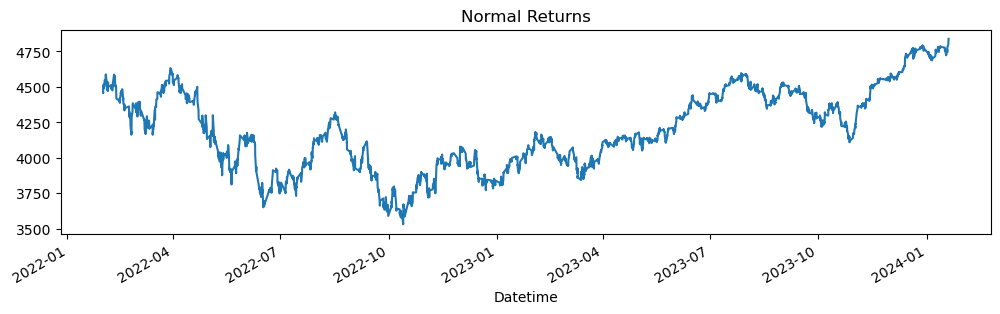

In [9]:
df['Close'].plot(title='Normal Returns', figsize=(12, 3), grid=False)

<Axes: title={'center': 'Log Returns'}, xlabel='Datetime'>

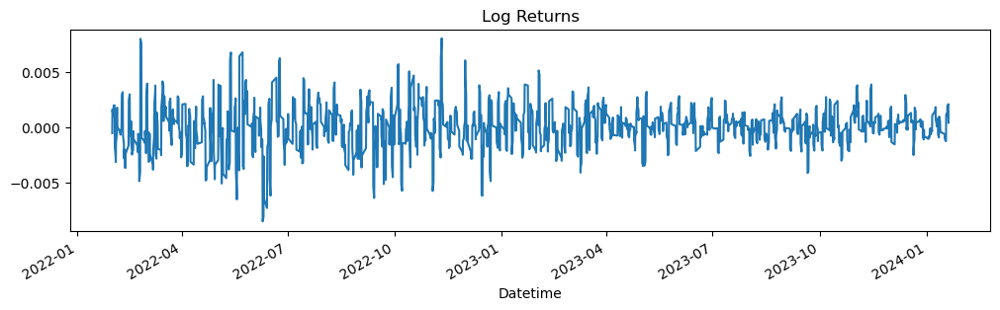

In [10]:
df_differenced['Close'].plot(title='Log Returns', figsize=(12, 3), grid=False)

#### Helper Functions to Plot Clusters - Different methods to represent clusters
1. Hourly (raw data points)
2. Max count by week
3. Max count by day then by week

In [11]:
def plot_time_series_by_hourly_regime(df):
    
    week_grp_df = df.groupby(pd.Grouper(freq='W'))

    fig = go.Figure()
    # Add background line plot
    fig.add_trace(go.Scatter(y=df.Close, x=df.index, mode="lines", line_color='lightgrey', showlegend=False))
      
    colors = {'0':'dodgerblue', '1':'orange', '2':'seagreen', '3':'crimson'}
    # Day followed by Week regime category
    for key, item in week_grp_df:
        prev_label = -1
        start_index = 0
        end_index = 0
        for index, row in item.iterrows():
            if prev_label == -1:
                prev_label = row['Regime']
                start_index, end_index = index, index
            else:
                if row['Regime'] == prev_label:
                    end_index = index
                else:
                    # Plot previous labels
                    cluster_color = list(map(colors.get, [prev_label]))[0]
                    
                    fig.add_trace(go.Scatter(y=item.loc[start_index:index].Close, x=item.loc[start_index:index].index,
                                             mode="markers+lines", line_color=cluster_color,  marker=dict(color=cluster_color, size=3), name=f"{start_index.strftime('%Y-%m-%d %I:%M %p')} to {index.strftime('%Y-%m-%d %I:%M %p')}"))
                    
                    # Reset index
                    prev_label = row['Regime']                         
                    start_index, end_index = index, index

            if index == item.index[-1]:
                # Last row
                cluster_color = list(map(colors.get, [prev_label]))[0]
                fig.add_trace(go.Scatter(y=item.loc[start_index:index].Close, x=item.loc[start_index:index].index, mode="markers+lines", line_color=cluster_color,
                                         marker=dict(color=cluster_color, size=3), name=f"{start_index.strftime('%Y-%m-%d %I:%M %p')} to {index.strftime('%Y-%m-%d %I:%M %p')}"))

    
    fig.update_layout(
        plot_bgcolor='white'
    )

    fig.update_xaxes(
            mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        range=[start, end],
        rangebreaks=[
            dict(values=[x for x in list(nyse_holidays.keys()) if x.weekday() != 4]),  # hide NYSE holidays excluding those that fall on a Friday. 
            # Plotly rangebreaks bug makes them overlap
            dict(bounds=["sat", "mon"]), #hide weekends
            dict(bounds=[16, 9.5], pattern="hour"), #hide hours outside of 9am-5pm
        ],
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey'
    )

    fig.show()

In [12]:
def plot_time_series_by_week_regime(df):
    
    week_grp_df = df.groupby(pd.Grouper(freq='W'))

    fig = go.Figure()
    # Add background line plot
    fig.add_trace(go.Scatter(y=df.Close, x=df.index, mode="lines", line_color='lightgrey', showlegend=False))
    
    # Week regime only
    for key, item in week_grp_df:
        elems, counts = np.unique(item.Regime.to_numpy(), return_counts=True)
        cluster_label = elems[counts.argmax()]
        colors = {'0':'dodgerblue', '1':'orange', '2':'seagreen', '3':'crimson'}
        cluster_color = list(map(colors.get, [cluster_label]))[0]
        
        fig.add_trace(go.Scatter(y=item.Close, x=item.index, mode="lines", line_color=cluster_color, name=key.strftime('%Y-%m-%d')))

    fig.update_layout(
        plot_bgcolor='white'
    )

    fig.update_xaxes(
            mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        range=[start, end],
        rangebreaks=[
            dict(values=[x for x in list(nyse_holidays.keys()) if x.weekday() != 4]),  # hide NYSE holidays excluding those that fall on a Friday. 
            # Plotly rangebreaks bug makes them overlap
            dict(bounds=["sat", "mon"]), #hide weekends
            dict(bounds=[16, 9.5], pattern="hour"), #hide hours outside of 9am-5pm
        ],
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey'
    )

    fig.show()

In [13]:
def plot_time_series_by_day_and_week_regime(df):
    
    week_grp_df = df.groupby(pd.Grouper(freq='W'))

    fig = go.Figure()
    # Add background line plot
    fig.add_trace(go.Scatter(y=df.Close, x=df.index, mode="lines", line_color='lightgrey', showlegend=False))
      
    # Day followed by Week regime category
    for key, item in week_grp_df:
        day_grp_df = item.groupby(pd.Grouper(freq='D'))
        day_dfs = []
        for k, i in day_grp_df:
            if i.empty:
                continue
            elems, counts = np.unique(i.Regime.to_numpy(), return_counts=True)
            cluster_label = elems[counts.argmax()]
            tmp_df = i.copy()
            tmp_df['Day_Regime'] = cluster_label
            day_dfs.append(tmp_df)
            
        day_df = pd.concat(day_dfs)
        # Find week regime based on day regimes
        elems, counts = np.unique(day_df.Day_Regime.to_numpy(), return_counts=True)
        cluster_label = elems[counts.argmax()]
        colors = {'0':'dodgerblue', '1':'orange', '2':'seagreen', '3':'crimson'}
        cluster_color = list(map(colors.get, [cluster_label]))[0]
        
        fig.add_trace(go.Scatter(y=item.Close, x=item.index, mode="lines", line_color=cluster_color, name=key.strftime('%Y-%m-%d')))

    fig.update_layout(
        plot_bgcolor='white'
    )

    fig.update_xaxes(
            mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey',
        range=[start, end],
        rangebreaks=[
            dict(values=[x for x in list(nyse_holidays.keys()) if x.weekday() != 4]),  # hide NYSE holidays excluding those that fall on a Friday. 
            # Plotly rangebreaks bug makes them overlap
            dict(bounds=["sat", "mon"]), #hide weekends
            dict(bounds=[16, 9.5], pattern="hour"), #hide hours outside of 9am-5pm
        ],
    )

    fig.update_yaxes(
        mirror=True,
        ticks='outside',
        showline=True,
        linecolor='black',
        gridcolor='lightgrey'
    )

    fig.show()

In [14]:
colors = {'0':'dodgerblue', '1':'orange', '2':'seagreen', '3':'crimson'}

In [15]:
def resample_data(df, length):
    Resampler = TimeSeriesResampler(sz=length)
    return Resampler.fit_transform(df)

def rescale_data(df):
    # Default mean = 0, std = 1
    Scaler = TimeSeriesScalerMeanVariance()
    return Scaler.fit_transform(df)

def df_add_weeks(df):
    data = []
    Scaler = TimeSeriesScalerMeanVariance()
    
    grp_df = df.groupby(pd.Grouper(freq='W'))
    
    combined_series = []
    combined_df = []
    
    min_length = float('inf')

    for key, item in grp_df:
        item = grp_df.get_group(key)
        series = item.Close.to_numpy()
        min_length = min(min_length, series.shape[0])
        combined_series.append(series)
        
    for week_idx, series in enumerate(combined_series):
        series_normalized = rescale_data(resample_data(series, min_length)).reshape(min_length)
        week_df = pd.DataFrame(series_normalized)
        week_df['week'] = week_idx
        week_df.columns = ['Close', 'Week']
        combined_df.append(week_df)

    return pd.concat(combined_df)

def df_transform_to_series(df):
    data = []
    for i in range(df.Week.nunique()):
        data.append(df.loc[df.Week == i].Close.to_numpy())

    return np.array(data)

In [16]:
def compute_sklearn_metrics(X, labels, scoring, metric=None, labels_true=None, km=None, X_train=None):
    if X.size == 0 or labels.size == 0 or not scoring:
        print('Missing Parameters')
        return
    
    # Transform X for sklearn 
    X_ = to_time_series_dataset(X)
    X_ = X_.reshape((X.shape[0],-1))
    
    if scoring == 'silhouette':
        if metric == 'dtw':
            return silhouette_score(cdist_dtw(X_), labels, metric='precomputed')
        elif metric == 'softdtw':
            # Add gamma parameter if necessary
            return silhouette_score(cdist_soft_dtw_normalized(X_, gamma=0.01), labels, metric='precomputed')
        else:
            return silhouette_score(X_, labels)
    else:
        if scoring == 'calinski_harabasz':
            return calinski_harabasz_score(X_, labels)
        elif scoring == 'calinski_harabasz_dtw':
            return calinski_harabasz_score_dtw(X_, labels, km)
        elif scoring == 'davies_bouldin':
            return davies_bouldin_score(X_, labels)
        elif scoring == 'davies_bouldin_dtw':
            return davies_bouldin_score_dtw(X_, labels, km)
        elif scoring == 'davies_bouldin_medoids':
            return davies_bouldin_score_medoids(X_, labels, km, X_train)
        elif scoring == 'davies_bouldin_medoids_dtw':
            return davies_bouldin_score_medoids(X_, labels, km, X_train, dtw=True)   
        elif scoring == 'v_measure_score':
            return v_measure_score(labels_true, labels)

In [17]:
def plot_metrics(df, y_pred, optimal_k):
    # Prep dataset
    X = df_transform_to_series(df_add_weeks(df))
    print(X.shape)
    sz = X.shape[1]
    
    #Metrics
    print("Metric Results")
    validation_index = ['silhouette']
    results = {vi: [] for vi in validation_index}

    for index in validation_index:
        results[index].append(compute_sklearn_metrics(X, y_pred, scoring=index))

    results_df = pd.DataFrame(results, index=[f"k={optimal_k}"])
    display(results_df)

    #Plotting
    subplot_index = 1
    plt.figure(figsize=(12, 9))

    for yi in range(optimal_k):
        plt.subplot(2, optimal_k, subplot_index + yi)
        for xx in X[y_pred == yi]:
            plt.plot(xx.ravel(), "k-", alpha=.2)
    #     plt.plot(km.cluster_centers_[yi].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
                 transform=plt.gca().transAxes)
        if yi == optimal_k//2:
            plt.title("Model Based Clustering Results")

    plt.tight_layout()
    plt.show()


In [28]:
def get_week_labels(df):
    week_grp_df = df.groupby(pd.Grouper(freq='W'))
    
    # Week regime only
    y_pred = []
    for key, item in week_grp_df:
        elems, counts = np.unique(item.Regime.to_numpy(), return_counts=True)
        cluster_label = elems[counts.argmax()]
        y_pred.append(int(cluster_label))
    
    return np.array(y_pred)

### Differenced Dataset + Model with Intercept (Trend)

#### 2 Regimes

In [18]:
# trend_model = sm.tsa.MarkovRegression(df_differenced['Close'].iloc[1:], k_regimes=2, exog=df_differenced['Close'].iloc[:-1], switching_variance=True)
trend_model = sm.tsa.MarkovRegression(df_differenced['Close'], k_regimes=2, switching_variance=True)
trend_model_result = trend_model.fit()
trend_model_result.summary()

C:\Users\rhysl\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


<class 'statsmodels.iolib.summary.Summary'>
"""
                        Markov Switching Model Results                        
==============================================================================
Dep. Variable:                  Close   No. Observations:                 3452
Model:               MarkovRegression   Log Likelihood               17670.439
Date:                Wed, 20 Mar 2024   AIC                         -35328.877
Time:                        12:57:46   BIC                         -35291.997
Sample:                             0   HQIC                        -35315.706
                               - 3452                                         
Covariance Type:               approx                                         
                             Regime 0 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.056e-06   2.81e-05      0.144      0.885    -5.1e-05    5.91e-05
sigma2      4.251e-07        nan        nan        nan         nan         nan
                             Regime 1 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       4.009e-05   6.06e-05      0.661      0.508   -7.87e-05       0.000
sigma2      5.699e-06   2.09e-07     27.255      0.000    5.29e-06    6.11e-06
                         Regime transition parameters                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
p[0->0]        0.9199      0.008    119.406      0.000       0.905       0.935
p[1->0]        0.0752      0.001     89.553      0.000       0.074       0.077
==============================================================================

Warnings:
[1] Covariance matrix calculated using numerical (complex-step) differentiation.
"""

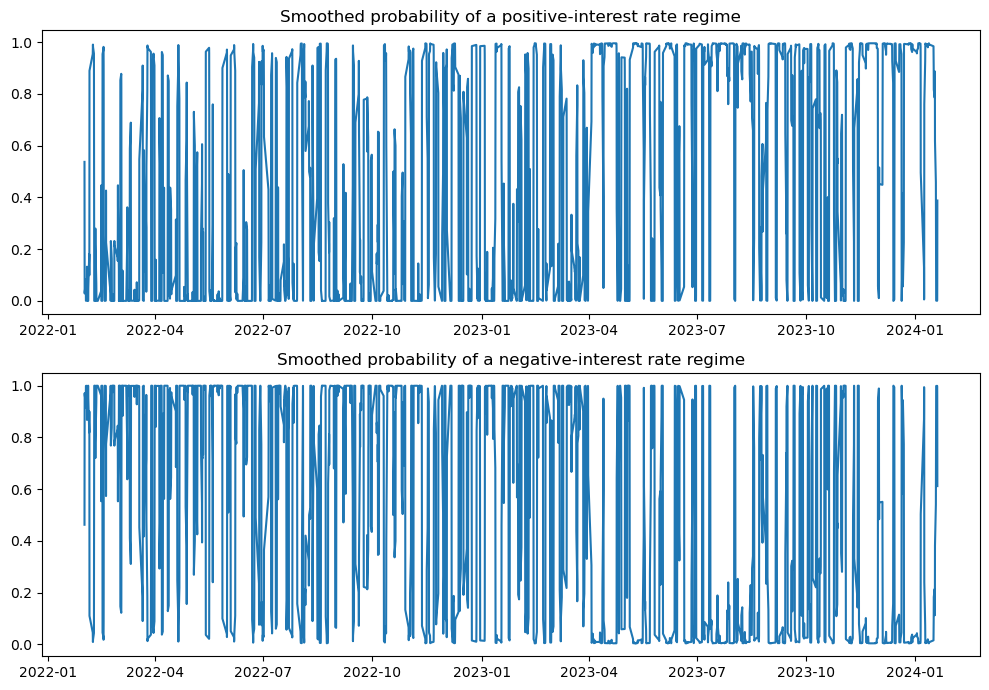

In [19]:
fig, axes = plt.subplots(2, figsize=(10, 7))

ax = axes[0]
ax.plot(trend_model_result.smoothed_marginal_probabilities[0])
ax.set(title="Smoothed probability of a positive-interest rate regime")

ax = axes[1]
ax.plot(trend_model_result.smoothed_marginal_probabilities[1])
ax.set(title="Smoothed probability of a negative-interest rate regime")

fig.tight_layout()

In [20]:
pos_var = list(trend_model_result.smoothed_marginal_probabilities[0])
neg_var = list(trend_model_result.smoothed_marginal_probabilities[1])

regime_list = []
for i in range(0, len(pos_var)): 
    regime_list.append(str(np.argmax([pos_var[i], neg_var[i]])))

trend_df_differenced = df_differenced.copy()
# trend_df_differenced = trend_df_differenced[1:]
trend_df_differenced['Regime'] = regime_list
trend_df_differenced.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,-0.000544,0
2022-01-31 11:30:00-05:00,0.000559,1
2022-01-31 12:30:00-05:00,0.001310,1
2022-01-31 13:30:00-05:00,0.001618,1
2022-01-31 14:30:00-05:00,0.001603,1


In [21]:
fig = px.scatter(trend_df_differenced, x=trend_df_differenced.index, y="Close", color= "Regime", color_discrete_map=colors)
fig.show()

In [22]:
trend_predicted_df = df.iloc[1:].copy()
trend_predicted_df['Regime'] = regime_list
trend_predicted_df.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,4455.779785,0
2022-01-31 11:30:00-05:00,4477.540039,1
2022-01-31 12:30:00-05:00,4482.819824,1
2022-01-31 13:30:00-05:00,4497.709961,1
2022-01-31 14:30:00-05:00,4486.180176,1


In [23]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=trend_predicted_df.index, y=trend_predicted_df.Close, mode="lines", line_color="grey", line_width=2, name='SP500 Price'))
# fig.update_traces(line_color='lightgrey')

# # Add traces
fig.add_trace(go.Scatter(x=trend_predicted_df.index, y=trend_predicted_df.Close, mode='markers', name = 'Regimes', marker=dict(color=trend_predicted_df.Regime.map(colors)), marker_size=4,))
fig.update_layout(plot_bgcolor='white')
fig.update_xaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey',)
fig.update_yaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey'
    )
fig.show()

In [24]:
plot_time_series_by_hourly_regime(trend_predicted_df)

In [25]:
plot_time_series_by_week_regime(trend_predicted_df)

In [26]:
plot_time_series_by_day_and_week_regime(trend_predicted_df)

(103, 24)
Metric Results


,silhouette
k=2,-0.006608


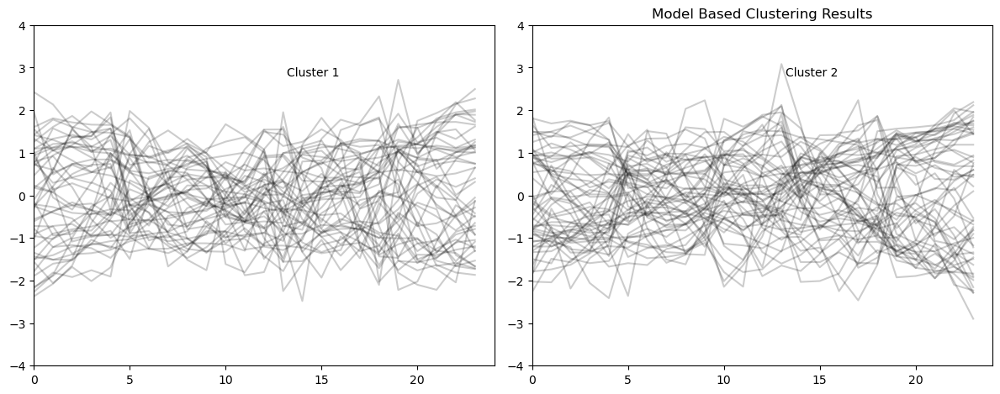

In [29]:
plot_metrics(trend_predicted_df, get_week_labels(trend_predicted_df), 2)

#### 3 Regimes

In [30]:
trend_model = sm.tsa.MarkovRegression(df_differenced['Close'], k_regimes=3, switching_variance=True)
trend_model_result = trend_model.fit()
trend_model_result.summary()

C:\Users\rhysl\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



<class 'statsmodels.iolib.summary.Summary'>
"""
                        Markov Switching Model Results                        
==============================================================================
Dep. Variable:                  Close   No. Observations:                 3452
Model:               MarkovRegression   Log Likelihood               18576.280
Date:                Wed, 20 Mar 2024   AIC                         -37128.560
Time:                        13:01:01   BIC                         -37054.799
Sample:                             0   HQIC                        -37102.217
                               - 3452                                         
Covariance Type:               approx                                         
                             Regime 0 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const      -2.325e-05   3.41e-05     -0.682      0.495   -9.01e-05    4.36e-05
sigma2       3.38e-07        nan        nan        nan         nan         nan
                             Regime 1 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0020   5.42e-05     37.223      0.000       0.002       0.002
sigma2      1.294e-06   7.21e-08     17.931      0.000    1.15e-06    1.44e-06
                             Regime 2 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0022   6.76e-05    -32.450      0.000      -0.002      -0.002
sigma2      1.549e-06   8.57e-08     18.084      0.000    1.38e-06    1.72e-06
                         Regime transition parameters                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
p[0->0]        0.8620      0.009     97.595      0.000       0.845       0.879
p[1->0]        0.1241        nan        nan        nan         nan         nan
p[2->0]        0.1412      0.007     19.679      0.000       0.127       0.155
p[0->1]        0.0698      0.006     12.298      0.000       0.059       0.081
p[1->1]        0.8759        nan        nan        nan         nan         nan
p[2->1]     3.524e-11        nan        nan        nan         nan         nan
==============================================================================

Warnings:
[1] Covariance matrix calculated using numerical (complex-step) differentiation.
"""

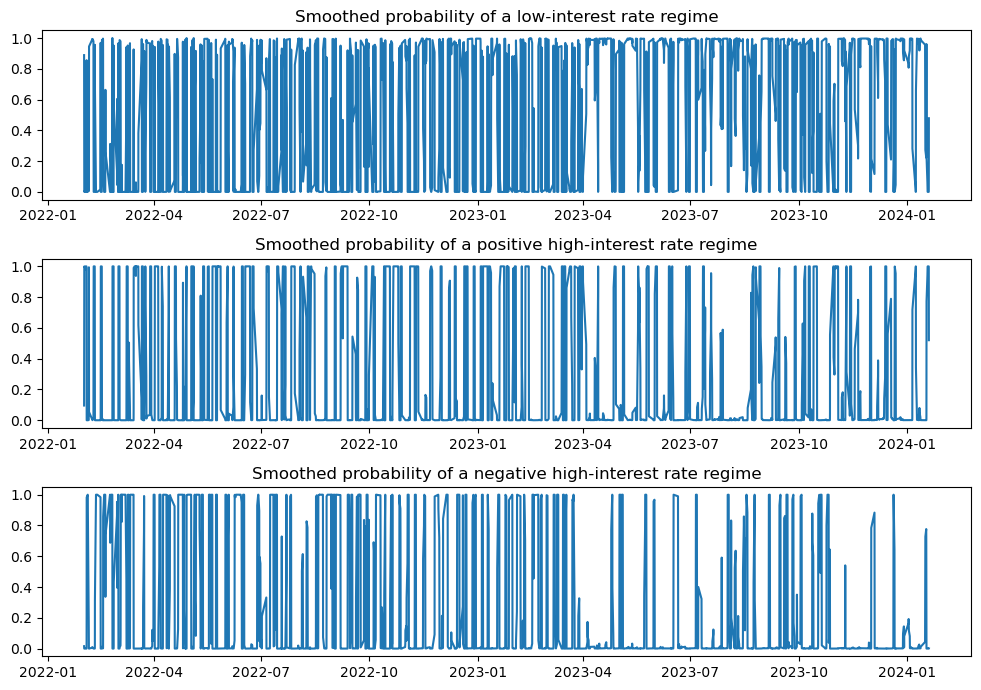

In [31]:
fig, axes = plt.subplots(3, figsize=(10, 7))

ax = axes[0]
ax.plot(trend_model_result.smoothed_marginal_probabilities[0])
ax.set(title="Smoothed probability of a low-interest rate regime")

ax = axes[1]
ax.plot(trend_model_result.smoothed_marginal_probabilities[1])
ax.set(title="Smoothed probability of a positive high-interest rate regime")

ax = axes[2]
ax.plot(trend_model_result.smoothed_marginal_probabilities[2])
ax.set(title="Smoothed probability of a negative high-interest rate regime")


fig.tight_layout()

In [32]:
low_var = list(trend_model_result.smoothed_marginal_probabilities[0])
pos_var = list(trend_model_result.smoothed_marginal_probabilities[1])
neg_var = list(trend_model_result.smoothed_marginal_probabilities[2])

regime_list = []
for i in range(0, len(low_var)): 
    regime_list.append(str(np.argmax([low_var[i], pos_var[i], neg_var[i]])))

trend_df_differenced = df_differenced.copy()
trend_df_differenced['Regime'] = regime_list
trend_df_differenced.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,-0.000544,0
2022-01-31 11:30:00-05:00,0.000559,0
2022-01-31 12:30:00-05:00,0.001310,1
2022-01-31 13:30:00-05:00,0.001618,1
2022-01-31 14:30:00-05:00,0.001603,1


In [33]:
fig = px.scatter(trend_df_differenced, x=trend_df_differenced.index, y="Close", color= "Regime", color_discrete_map=colors)
fig.show()

In [34]:
trend_predicted_df = df.iloc[1:].copy()
trend_predicted_df['Regime'] = regime_list
trend_predicted_df.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,4455.779785,0
2022-01-31 11:30:00-05:00,4477.540039,0
2022-01-31 12:30:00-05:00,4482.819824,1
2022-01-31 13:30:00-05:00,4497.709961,1
2022-01-31 14:30:00-05:00,4486.180176,1


In [35]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=trend_predicted_df.index, y=trend_predicted_df.Close, mode="lines", line_color="grey", line_width=2, name='SP500 Price'))
# fig.update_traces(line_color='lightgrey')

# # Add traces
fig.add_trace(go.Scatter(x=trend_predicted_df.index, y=trend_predicted_df.Close, mode='markers', name = 'Regimes', marker=dict(color=trend_predicted_df.Regime.map(colors)), marker_size=4,))
fig.update_layout(plot_bgcolor='white')
fig.update_xaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey',)
fig.update_yaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey'
    )
fig.show()

In [36]:
plot_time_series_by_hourly_regime(trend_predicted_df)

In [37]:
plot_time_series_by_week_regime(trend_predicted_df)

In [38]:
plot_time_series_by_day_and_week_regime(trend_predicted_df)

(103, 24)
Metric Results


,silhouette
k=3,-0.039373


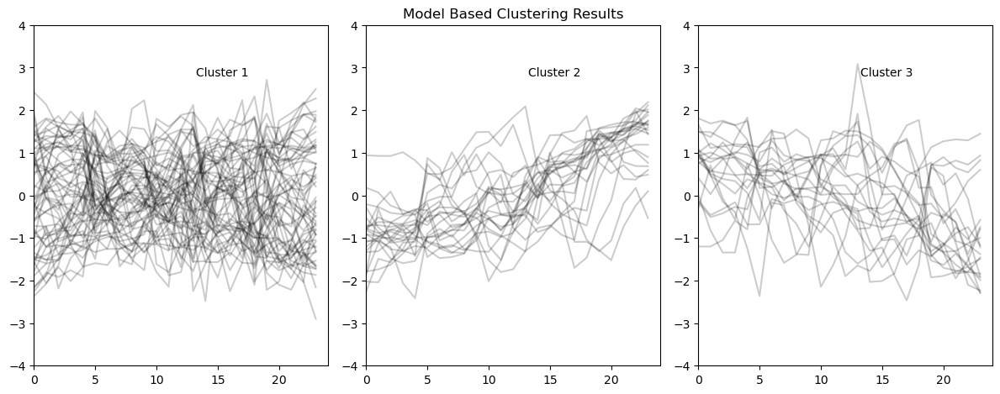

In [39]:
plot_metrics(trend_predicted_df, get_week_labels(trend_predicted_df), 3)

#### 4 Regimes

In [40]:
trend_model = sm.tsa.MarkovRegression(df_differenced['Close'], k_regimes=4, switching_variance=True)
trend_model_result = trend_model.fit()
trend_model_result.summary()

C:\Users\rhysl\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\rhysl\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



<class 'statsmodels.iolib.summary.Summary'>
"""
                        Markov Switching Model Results                        
==============================================================================
Dep. Variable:                  Close   No. Observations:                 3452
Model:               MarkovRegression   Log Likelihood               19089.606
Date:                Wed, 20 Mar 2024   AIC                         -38139.213
Time:                        13:03:05   BIC                         -38016.279
Sample:                             0   HQIC                        -38095.308
                               - 3452                                         
Covariance Type:               approx                                         
                             Regime 0 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0006   3.66e-05    -17.509      0.000      -0.001      -0.001
sigma2      1.893e-07        nan        nan        nan         nan         nan
                             Regime 1 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0023   5.35e-05     42.172      0.000       0.002       0.002
sigma2      1.254e-06   2.52e-08     49.700      0.000     1.2e-06     1.3e-06
                             Regime 2 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0005   3.48e-05     14.313      0.000       0.000       0.001
sigma2      1.659e-07        nan        nan        nan         nan         nan
                             Regime 3 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0026    4.1e-05    -63.739      0.000      -0.003      -0.003
sigma2      1.464e-06    5.9e-08     24.836      0.000    1.35e-06    1.58e-06
                         Regime transition parameters                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
p[0->0]        0.7571      0.016     47.889      0.000       0.726       0.788
p[1->0]        0.0001        nan        nan        nan         nan         nan
p[2->0]        0.1458      0.008     17.570      0.000       0.130       0.162
p[3->0]        0.1547      0.019      8.090      0.000       0.117       0.192
p[0->1]        0.0034      0.011      0.305      0.760      -0.018       0.025
p[1->1]        0.8607      0.012     71.823      0.000       0.837       0.884
p[2->1]        0.0926      0.009     10.729      0.000       0.076       0.110
p[3->1]        0.0106      0.012      0.899      0.368      -0.013       0.034
p[0->2]        0.1500      0.013     11.701      0.000       0.125       0.175
p[1->2]        0.1366      0.012     11.128      0.000       0.113       0.161
p[2->2]        0.7592      0.013     60.515      0.000       0.735       0.784
p[3->2]        0.0005      0.016      0.032      0.974      -0.030       0.031
==============================================================================

W

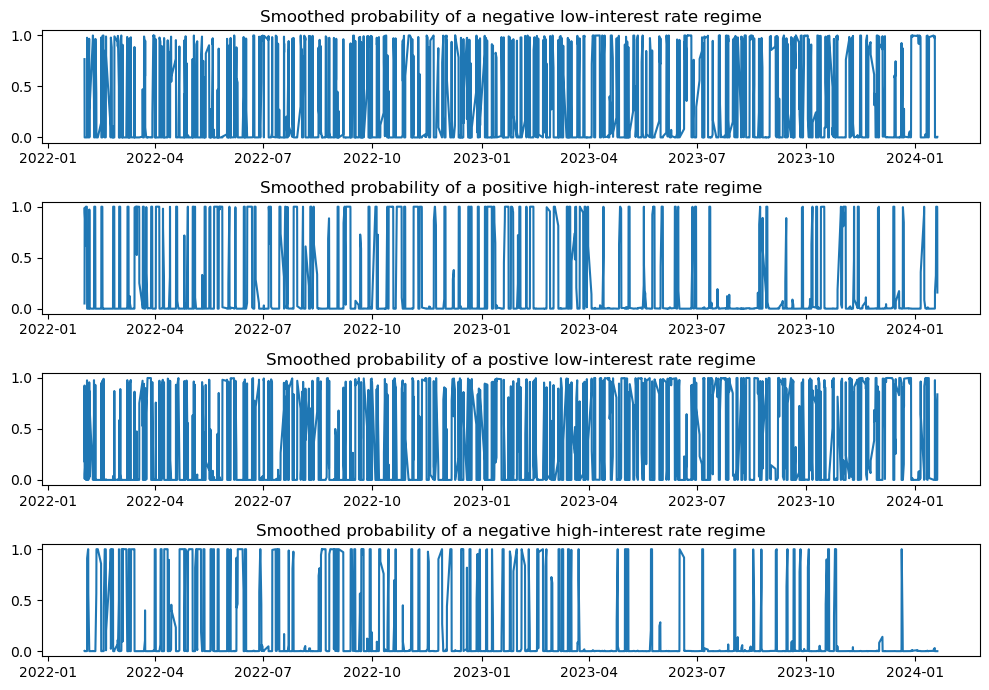

In [41]:
fig, axes = plt.subplots(4, figsize=(10, 7))

ax = axes[0]
ax.plot(trend_model_result.smoothed_marginal_probabilities[0])
ax.set(title="Smoothed probability of a negative low-interest rate regime")

ax = axes[1]
ax.plot(trend_model_result.smoothed_marginal_probabilities[1])
ax.set(title="Smoothed probability of a positive high-interest rate regime")

ax = axes[2]
ax.plot(trend_model_result.smoothed_marginal_probabilities[2])
ax.set(title="Smoothed probability of a postive low-interest rate regime")

ax = axes[3]
ax.plot(trend_model_result.smoothed_marginal_probabilities[3])
ax.set(title="Smoothed probability of a negative high-interest rate regime")

fig.tight_layout()

In [42]:
neg_low_var = list(trend_model_result.smoothed_marginal_probabilities[0])
pos_high_var = list(trend_model_result.smoothed_marginal_probabilities[1])
pos_low_var = list(trend_model_result.smoothed_marginal_probabilities[2])
neg_high_var = list(trend_model_result.smoothed_marginal_probabilities[3])

regime_list = []
for i in range(0, len(low_var)): 
    regime_list.append(str(np.argmax([neg_low_var[i], pos_high_var[i], pos_low_var[i], neg_high_var[i]])))

trend_df_differenced = df_differenced.copy()
trend_df_differenced['Regime'] = regime_list
trend_df_differenced.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,-0.000544,0
2022-01-31 11:30:00-05:00,0.000559,2
2022-01-31 12:30:00-05:00,0.001310,1
2022-01-31 13:30:00-05:00,0.001618,1
2022-01-31 14:30:00-05:00,0.001603,1


In [43]:
fig = px.scatter(trend_df_differenced, x=trend_df_differenced.index, y="Close", color= "Regime", color_discrete_map=colors)
fig.show()

In [44]:
trend_predicted_df = df.iloc[1:].copy()
trend_predicted_df['Regime'] = regime_list
trend_predicted_df.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,4455.779785,0
2022-01-31 11:30:00-05:00,4477.540039,2
2022-01-31 12:30:00-05:00,4482.819824,1
2022-01-31 13:30:00-05:00,4497.709961,1
2022-01-31 14:30:00-05:00,4486.180176,1


In [45]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=trend_predicted_df.index, y=trend_predicted_df.Close, mode="lines", line_color="grey", line_width=2, name='SP500 Price'))
# fig.update_traces(line_color='lightgrey')

# # Add traces
fig.add_trace(go.Scatter(x=trend_predicted_df.index, y=trend_predicted_df.Close, mode='markers', name = 'Regimes', marker=dict(color=trend_predicted_df.Regime.map(colors)), marker_size=4,))
fig.update_layout(plot_bgcolor='white')
fig.update_xaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey',)
fig.update_yaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey'
    )
fig.show()

In [46]:
plot_time_series_by_hourly_regime(trend_predicted_df)

In [47]:
plot_time_series_by_week_regime(trend_predicted_df)

In [48]:
plot_time_series_by_day_and_week_regime(trend_predicted_df)

(103, 24)
Metric Results


,silhouette
k=4,-0.064348


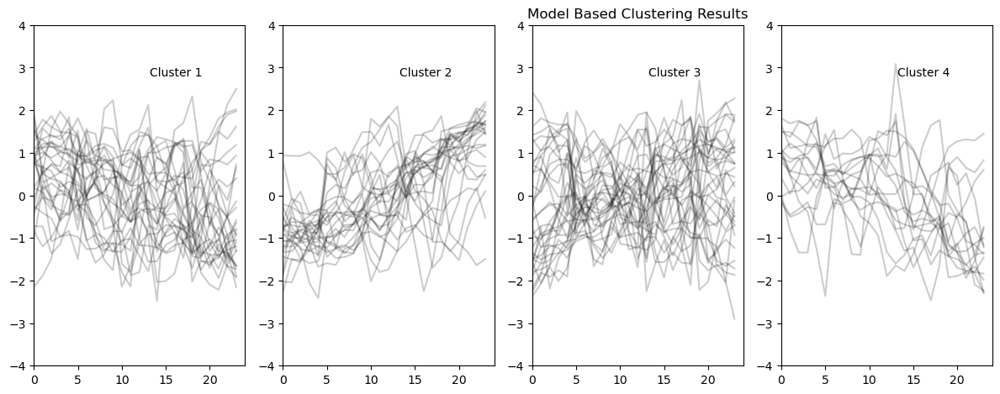

In [49]:
plot_metrics(trend_predicted_df, get_week_labels(trend_predicted_df), 4)

### Differenced Dataset + Model without Intercept (Trend)

#### 2 Regimes

In [50]:
non_trend_model = sm.tsa.MarkovRegression(df_differenced['Close'], k_regimes=2, trend = 'n', switching_variance=True)
non_trend_model_result = non_trend_model.fit()
non_trend_model_result.summary()

C:\Users\rhysl\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



<class 'statsmodels.iolib.summary.Summary'>
"""
                        Markov Switching Model Results                        
==============================================================================
Dep. Variable:                  Close   No. Observations:                 3452
Model:               MarkovRegression   Log Likelihood               17670.157
Date:                Wed, 20 Mar 2024   AIC                         -35332.314
Time:                        13:03:22   BIC                         -35307.727
Sample:                             0   HQIC                        -35323.533
                               - 3452                                         
Covariance Type:               approx                                         
                             Regime 0 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      4.251e-07        nan        nan        nan         nan         nan
                             Regime 1 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      5.701e-06   2.09e-07     27.253      0.000    5.29e-06    6.11e-06
                         Regime transition parameters                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
p[0->0]        0.9200      0.008    119.496      0.000       0.905       0.935
p[1->0]        0.0752      0.001     89.841      0.000       0.074       0.077
==============================================================================

Warnings:
[1] Covariance matrix calculated using numerical (complex-step) differentiation.
"""

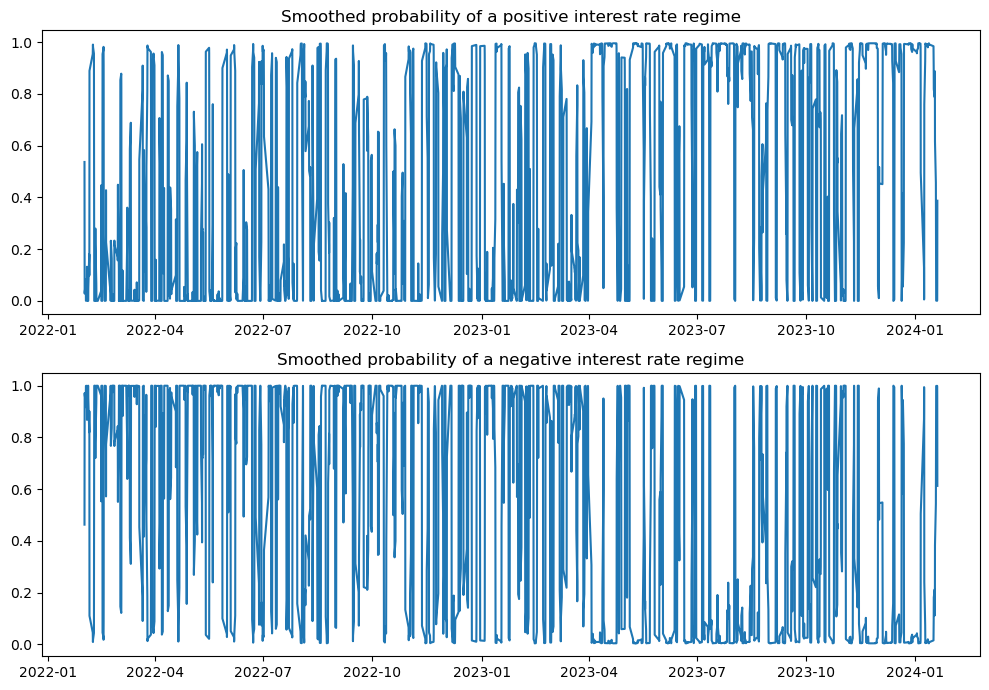

In [51]:
fig, axes = plt.subplots(2, figsize=(10, 7))

ax = axes[0]
ax.plot(non_trend_model_result.smoothed_marginal_probabilities[0])
ax.set(title="Smoothed probability of a positive interest rate regime")

ax = axes[1]
ax.plot(non_trend_model_result.smoothed_marginal_probabilities[1])
ax.set(title="Smoothed probability of a negative interest rate regime")

fig.tight_layout()

In [52]:
pos_var = list(non_trend_model_result.smoothed_marginal_probabilities[0])
neg_var = list(non_trend_model_result.smoothed_marginal_probabilities[1])

regime_list = []
for i in range(0, len(low_var)): 
    regime_list.append(str(np.argmax([pos_var[i], neg_var[i]])))

non_trend_df_differenced = df_differenced.copy()
non_trend_df_differenced['Regime'] = regime_list
non_trend_df_differenced.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,-0.000544,0
2022-01-31 11:30:00-05:00,0.000559,1
2022-01-31 12:30:00-05:00,0.001310,1
2022-01-31 13:30:00-05:00,0.001618,1
2022-01-31 14:30:00-05:00,0.001603,1


In [53]:
fig = px.scatter(non_trend_df_differenced, x=non_trend_df_differenced.index, y="Close", color= "Regime", color_discrete_map=colors)
fig.show()

In [54]:
non_trend_predicted_df = df.iloc[1:].copy()
non_trend_predicted_df['Regime'] = regime_list
non_trend_predicted_df.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,4455.779785,0
2022-01-31 11:30:00-05:00,4477.540039,1
2022-01-31 12:30:00-05:00,4482.819824,1
2022-01-31 13:30:00-05:00,4497.709961,1
2022-01-31 14:30:00-05:00,4486.180176,1


In [55]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=non_trend_predicted_df.index, y=non_trend_predicted_df.Close, mode="lines", line_color="grey", line_width=2, name='SP500 Price'))
# fig.update_traces(line_color='lightgrey')

# # Add traces
fig.add_trace(go.Scatter(x=non_trend_predicted_df.index, y=non_trend_predicted_df.Close, mode='markers', name = 'Regimes', marker=dict(color=non_trend_predicted_df.Regime.map(colors)), marker_size=4,))
fig.update_layout(plot_bgcolor='white')
fig.update_xaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey',)
fig.update_yaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey'
    )
fig.show()

In [56]:
plot_time_series_by_week_regime(non_trend_predicted_df)

(103, 24)
Metric Results


,silhouette
k=2,-0.006608


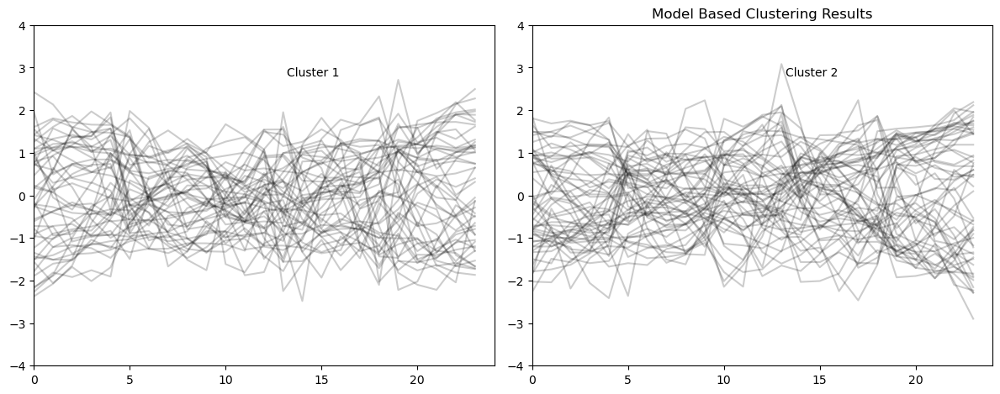

In [57]:
plot_metrics(non_trend_predicted_df, get_week_labels(non_trend_predicted_df), 2)

#### 3 Regimes

In [58]:
non_trend_model = sm.tsa.MarkovRegression(df_differenced['Close'], k_regimes=3, trend='n', switching_variance=True)
# non_trend_model = sm.tsa.MarkovAutoregression(df['Close'], k_regimes=3, order=4)
non_trend_model_result = non_trend_model.fit()
non_trend_model_result.summary()

C:\Users\rhysl\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



<class 'statsmodels.iolib.summary.Summary'>
"""
                        Markov Switching Model Results                        
==============================================================================
Dep. Variable:                  Close   No. Observations:                 3452
Model:               MarkovRegression   Log Likelihood               17810.115
Date:                Wed, 20 Mar 2024   AIC                         -35602.230
Time:                        13:03:49   BIC                         -35546.910
Sample:                             0   HQIC                        -35582.473
                               - 3452                                         
Covariance Type:               approx                                         
                             Regime 0 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      1.871e-07        nan        nan        nan         nan         nan
                             Regime 1 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2        1.8e-06   1.26e-07     14.263      0.000    1.55e-06    2.05e-06
                             Regime 2 parameters                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      9.708e-06   6.84e-07     14.193      0.000    8.37e-06     1.1e-05
                         Regime transition parameters                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
p[0->0]        0.8821   5.15e-05   1.71e+04      0.000       0.882       0.882
p[1->0]        0.0643      0.007      9.118      0.000       0.050       0.078
p[2->0]     8.636e-16        nan        nan        nan         nan         nan
p[0->1]        0.1179   1.88e-05   6260.585      0.000       0.118       0.118
p[1->1]        0.8825      0.011     77.829      0.000       0.860       0.905
p[2->1]        0.1183      0.007     15.892      0.000       0.104       0.133
==============================================================================

Warnings:
[1] Covariance matrix calculated using numerical (complex-step) differentiation.
"""

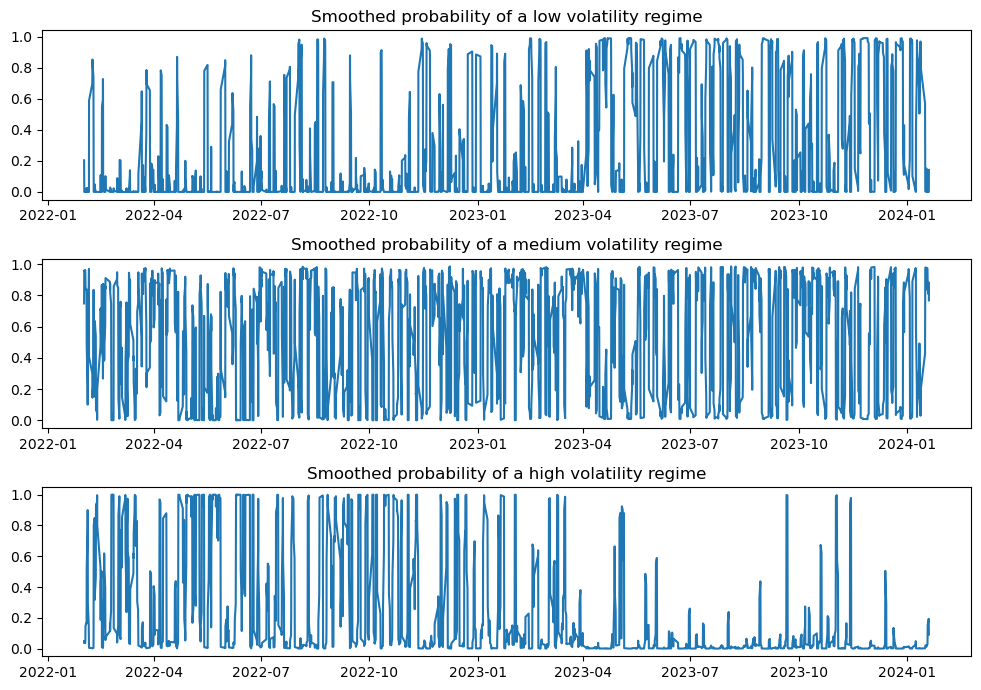

In [59]:
fig, axes = plt.subplots(3, figsize=(10, 7))

ax = axes[0]
ax.plot(non_trend_model_result.smoothed_marginal_probabilities[0])
ax.set(title="Smoothed probability of a low volatility regime")

ax = axes[1]
ax.plot(non_trend_model_result.smoothed_marginal_probabilities[1])
ax.set(title="Smoothed probability of a medium volatility regime")

ax = axes[2]
ax.plot(non_trend_model_result.smoothed_marginal_probabilities[2])
ax.set(title="Smoothed probability of a high volatility regime")

fig.tight_layout()

In [60]:
low_var = list(non_trend_model_result.smoothed_marginal_probabilities[0])
mid_var = list(non_trend_model_result.smoothed_marginal_probabilities[1])
high_var = list(non_trend_model_result.smoothed_marginal_probabilities[2])

regime_list = []
for i in range(0, len(low_var)): 
    regime_list.append(str(np.argmax([low_var[i], mid_var[i], high_var[i]])))

non_trend_df_differenced = df_differenced.copy()
non_trend_df_differenced['Regime'] = regime_list
non_trend_df_differenced.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,-0.000544,1
2022-01-31 11:30:00-05:00,0.000559,1
2022-01-31 12:30:00-05:00,0.001310,1
2022-01-31 13:30:00-05:00,0.001618,1
2022-01-31 14:30:00-05:00,0.001603,1


In [61]:
colors = {'0':'dodgerblue', '1':'orange', '2':'seagreen', '3':'crimson'}

fig = px.scatter(non_trend_df_differenced, x=non_trend_df_differenced.index, y="Close", color= "Regime", color_discrete_map=colors)
fig.show()

In [62]:
non_trend_predicted_df = df.iloc[1:].copy()
non_trend_predicted_df['Regime'] = regime_list
non_trend_predicted_df.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,4455.779785,1
2022-01-31 11:30:00-05:00,4477.540039,1
2022-01-31 12:30:00-05:00,4482.819824,1
2022-01-31 13:30:00-05:00,4497.709961,1
2022-01-31 14:30:00-05:00,4486.180176,1


In [63]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=non_trend_predicted_df.index, y=non_trend_predicted_df.Close, mode="lines", line_color="grey", line_width=2, name='SP500 Price'))
# fig.update_traces(line_color='lightgrey')

# # Add traces
fig.add_trace(go.Scatter(x=non_trend_predicted_df.index, y=non_trend_predicted_df.Close, mode='markers', name = 'Regimes', marker=dict(color=non_trend_predicted_df.Regime.map(colors)), marker_size=4,))
fig.update_layout(plot_bgcolor='white')
fig.update_xaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey',)
fig.update_yaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey'
    )
fig.show()

In [64]:
non_trend_predicted_df_differenced = df_differenced.copy()
non_trend_predicted_df_differenced['Regime'] = regime_list
non_trend_predicted_df_differenced.head()

,Close,Regime
Datetime,,
2022-01-31 10:30:00-05:00,-0.000544,1
2022-01-31 11:30:00-05:00,0.000559,1
2022-01-31 12:30:00-05:00,0.001310,1
2022-01-31 13:30:00-05:00,0.001618,1
2022-01-31 14:30:00-05:00,0.001603,1


In [65]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=non_trend_predicted_df_differenced.index, y=non_trend_predicted_df_differenced.Close, mode="lines", line_color="grey", line_width=2, name='SP500 Price'))
# fig.update_traces(line_color='lightgrey')

# # Add traces
fig.add_trace(go.Scatter(x=non_trend_predicted_df_differenced.index, y=non_trend_predicted_df_differenced.Close, mode='markers', name = 'Regimes', marker=dict(color=non_trend_predicted_df_differenced.Regime.map(colors)), marker_size=4,))
fig.update_layout(plot_bgcolor='white')
fig.update_xaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey',)
fig.update_yaxes(
        mirror=True,
        linecolor='black',
        gridcolor='lightgrey'
    )
fig.show()

In [66]:
plot_time_series_by_hourly_regime(non_trend_predicted_df)

In [67]:
plot_time_series_by_week_regime(non_trend_predicted_df)

In [68]:
plot_time_series_by_day_and_week_regime(non_trend_predicted_df)

(103, 24)
Metric Results


,silhouette
k=3,-0.02454


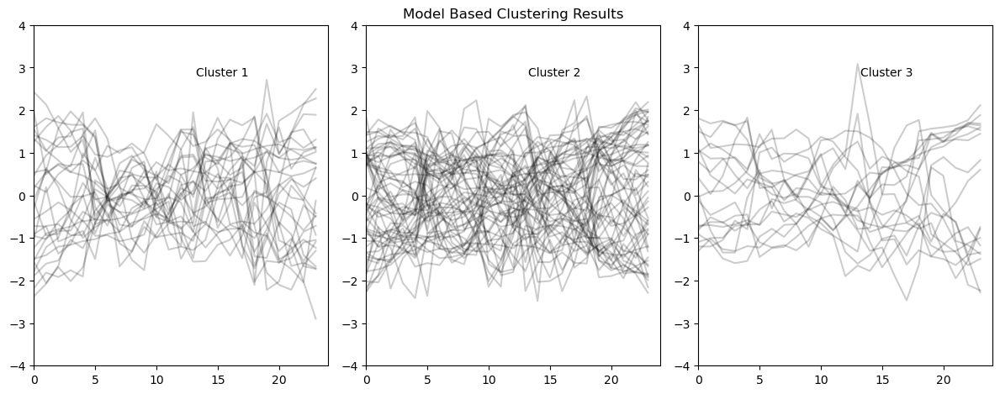

In [69]:
plot_metrics(non_trend_predicted_df, get_week_labels(non_trend_predicted_df), 3)